# Pothole Detection

This lab is to perform pothole detection from the dataset in [Kaggle](https://www.kaggle.com/datasets/farzadnekouei/pothole-image-segmentation-dataset) and [notebook](https://www.kaggle.com/code/farzadnekouei/pothole-segmentation-for-road-damage-assessment/notebook).

We will learn how to use [YOLOv8](https://docs.ultralytics.com/) to train a custom pothole detection model.

## Step 1 | Setup and Initialization

YOLOv8-seg, launched by Ultralytics, is accessible for easy installation via pip. Let's start by installing the Ultralytics package:

In [ ]:
# Install Ultralytics library
!pip install ultralytics

You will need to **Restart the kernel**

Now we will unzip the dataset file into the folder.

In [ ]:
!tar -xvf dataset.tar.gz

Next, I will import all necessary libraries required for our project:

In [1]:
# Disable warnings in the notebook to maintain clean output cells
import warnings
warnings.filterwarnings('ignore')

# Import necessary libraries
import os
import shutil
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import random
import cv2
import yaml
from PIL import Image
from collections import deque
from ultralytics import YOLO
from IPython.display import Video

In [2]:
# Configure the visual appearance of Seaborn plots
sns.set(rc={'axes.facecolor': '#ffe4de'}, style='darkgrid')

## Step 2 | Loading YOLOv8-seg Pre-trained Model

Here are the YOLOv8 pretrained Segment models. They come in various configurations, each optimized for speed and accuracy, and are pretrained on the COCO dataset, which includes 80 diverse object categories:


<img src="https://github.com/FarzadNekouee/YOLOv8_Pothole_Segmentation_Road_Damage_Assessment/blob/master/images/YOLOv8_segmentation_models.png?raw=true" width="2400">

### Choosing YOLOv8n-seg for Speed

The YOLOv8-seg lineup ranges from nano to xlarge, each striking a different balance between accuracy and speed. While larger models offer increased precision, they do so at the expense of response time. For our Pothole Segmentation task, which demands prompt processing, the YOLOv8n-seg is our chosen model. It's tailored for the fastest inference, making it highly suitable for real-time applications:

In [3]:
# Load the pre-trained YOLOv8 nano segmentation model
model = YOLO('yolov8n-seg.pt') 

After loading the YOLOv8 nano segmentation model, it's important to note that 'pothole' is not one of the 80 object categories the model was initially trained to recognize in the COCO dataset. To identify potholes, we'll need to fine-tune the model on a specialized dataset of pothole images for precise segmentation.

## Step 3 | Dataset Exploration

### Dataset Preparation for Model Fine-tuning

I've compiled a dataset specifically for training our pothole segmentation model, available on Kaggle. This dataset includes 780 images, with 720 for training and 60 for validation. Each image has been prepared to align correctly and resized to 640x640 pixels. To enhance the model's learning, the training images have undergone various augmentations, such as flipping, cropping, rotating, shearing, and adjusting brightness and exposure. This thorough preparation ensures our model will learn to identify and segment potholes effectively.

### YOLOv8-seg Dataset Format
I've formatted our dataset specifically for the YOLOv8-seg model, prepared on Roboflow. It includes all elements essential for training a segmentation model effectively. Here is a breakdown:

1. train and valid directories:

Our dataset is split into train and valid directories, each with images and labels subdirectories. The train contains 720 image-label pairs, while valid has 60. Label files detail the class index and normalized coordinates for each pothole instance in the [class-index] [x1] [y1] [x2] [y2] ... [xn] [yn]  format. In this format, [class-index] is the index of the class for the object, and [x1] [y1] [x2] [y2] ... [xn] [yn] are the bounding coordinates of the object's segmentation mask. The coordinates are separated by spaces.

2. data.yaml:

The data.yaml file which is the Ultralytics YOLO dataset configuration file. It specifies paths to the training and validation datasets, defines the number of classes (1), and the class name (‘Pothole’). This format is crucial for setting up and training the model accurately with our dataset. Let's review the data.yaml to understand the setup:

In [4]:
# Define the dataset_path
dataset_path = '/home/jupyter/vertexai-vision-lab/Pothole_Segmentation_YOLOv8'

# Set the path to the YAML file
yaml_file_path = os.path.join(dataset_path, 'data.yaml')

# Load and print the contents of the YAML file
with open(yaml_file_path, 'r') as file:
    yaml_content = yaml.load(file, Loader=yaml.FullLoader)
    print(yaml.dump(yaml_content, default_flow_style=False))

names:
- Pothole
nc: 1
roboflow:
  license: CC BY 4.0
  project: pothole_segmentation_yolov8
  url: https://universe.roboflow.com/farzad/pothole_segmentation_yolov8/dataset/1
  version: 1
  workspace: farzad
train: ../train/images
val: ../valid/images



### Understanding the data.yaml File

The data.yaml file is crucial for configuring our model; it locates the training (train: ../train/images) and validation (val: ../valid/images) images and specifies that we're detecting a single class (nc: 1), Pothole. This setup ensures our YOLOv8-seg model is finely tuned to identify and segment potholes from our custom dataset. It's the guide that helps our model learn precisely what to look for during the segmentation task.

Now, let's continue our exploration by counting the images in both the training and validation sets and verifying their sizes:

In [5]:
# Set paths for training and validation image sets
train_images_path = os.path.join(dataset_path, 'train', 'images')
valid_images_path = os.path.join(dataset_path, 'valid', 'images')

# Initialize counters for the number of images
num_train_images = 0
num_valid_images = 0

# Initialize sets to hold the unique sizes of images
train_image_sizes = set()
valid_image_sizes = set()

# Check train images sizes and count
for filename in os.listdir(train_images_path):
    if filename.endswith('.jpg'):  
        num_train_images += 1
        image_path = os.path.join(train_images_path, filename)
        with Image.open(image_path) as img:
            train_image_sizes.add(img.size)

# Check validation images sizes and count
for filename in os.listdir(valid_images_path):
    if filename.endswith('.jpg'): 
        num_valid_images += 1
        image_path = os.path.join(valid_images_path, filename)
        with Image.open(image_path) as img:
            valid_image_sizes.add(img.size)

# Print the results
print(f"Number of training images: {num_train_images}")
print(f"Number of validation images: {num_valid_images}")

# Check if all images in training set have the same size
if len(train_image_sizes) == 1:
    print(f"All training images have the same size: {train_image_sizes.pop()}")
else:
    print("Training images have varying sizes.")

# Check if all images in validation set have the same size
if len(valid_image_sizes) == 1:
    print(f"All validation images have the same size: {valid_image_sizes.pop()}")
else:
    print("Validation images have varying sizes.")

Number of training images: 720
Number of validation images: 60
All training images have the same size: (640, 640)
All validation images have the same size: (640, 640)


### Dataset Analysis Insights

For our Pothole Segmentation project, the dataset comprises 720 training images and 60 validation images. All images are consistently sized at 640x640 pixels, matching the YOLOv8-seg model's input specifications. This uniformity ensures that the model trains and validates efficiently. The training to validation split provides a robust dataset for learning and a sufficient number for validation to assess the model's performance accurately.

Finally at this step, let's take a look at a few images from the dataset to get a sense of what the data looks like:

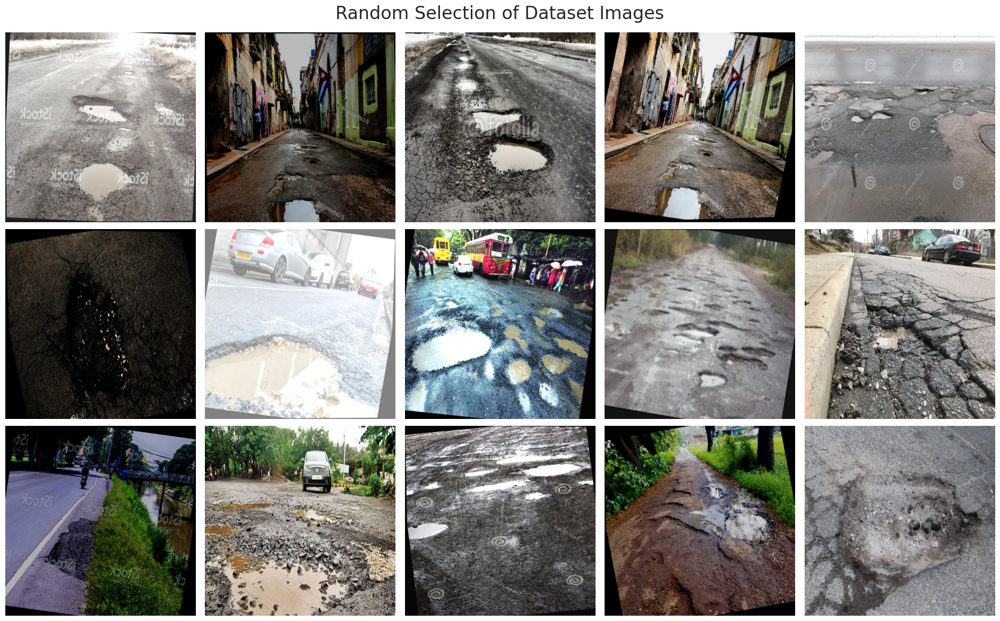

In [6]:
# Set the seed for the random number generator
random.seed(0)

# Create a list of image files
image_files = [f for f in os.listdir(train_images_path) if f.endswith('.jpg')]

# Randomly select 15 images
random_images = random.sample(image_files, 15)

# Create a new figure
plt.figure(figsize=(19, 12))

# Loop through each image and display it in a 3x5 grid
for i, image_file in enumerate(random_images):
    image_path = os.path.join(train_images_path, image_file)
    image = Image.open(image_path)
    plt.subplot(3, 5, i + 1)
    plt.imshow(image)
    plt.axis('off')

# Add a suptitle
plt.suptitle('Random Selection of Dataset Images', fontsize=24)

# Show the plot
plt.tight_layout()
plt.show()

# Deleting unnecessary variable to free up memory
del image_files

## Step 4 | Fine-Tuning YOLOv8-seg

In this step, I'll use transfer learning to fine-tune the YOLOv8-seg model, initially trained on the COCO dataset, for our Pothole Image Segmentation Dataset. Instead of starting the training from scratch with random weights, which requires a lot of data and time, I'll start with a model that already knows how to recognize various objects. This way, we save time and make the most out of our smaller dataset to teach the model how to identify and segment potholes in road images:

In [7]:
# Train the model on our custom dataset
results = model.train(
    data=yaml_file_path,     # Path to the dataset configuration file
    epochs=150,              # Number of epochs to train for
    imgsz=640,               # Size of input images as integer
    patience=15,             # Epochs to wait for no observable improvement for early stopping of training
    batch=16,                # Number of images per batch
    optimizer='auto',        # Optimizer to use, choices=[SGD, Adam, Adamax, AdamW, NAdam, RAdam, RMSProp, auto]
    lr0=0.0001,              # Initial learning rate 
    lrf=0.01,                # Final learning rate (lr0 * lrf)
    dropout=0.25,            # Use dropout regularization
    #device=0,                # Device to run on, i.e. cuda device=0 only when there is GPU in the workbench
    seed=42                  # Random seed for reproducibility
)

Ultralytics 8.3.48 🚀 Python-3.10.15 torch-2.5.1+cu124 CUDA:0 (NVIDIA L4, 22478MiB)
engine/trainer: task=segment, mode=train, model=yolov8n-seg.pt, data=/home/jupyter/vertexai-vision-lab/Pothole_Segmentation_YOLOv8/data.yaml, epochs=150, time=None, patience=15, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=42, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.25, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_cro

train: Scanning /home/jupyter/vertexai-vision-lab/Pothole_Segmentation_YOLOv8/train/labels.cache... 720 images, 0 backgrounds, 0 corrupt: 100%|██████████| 720/720 [00:00<?, ?it/s]
val: Scanning /home/jupyter/vertexai-vision-lab/Pothole_Segmentation_YOLOv8/valid/labels.cache... 60 images, 0 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:00<?, ?it/s]


Plotting labels to runs/segment/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.0001' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 66 weight(decay=0.0), 77 weight(decay=0.0005), 76 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/segment/train
Starting training for 150 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      1/150      2.99G      1.556       3.29       2.38      1.535         86        640: 100%|██████████| 45/45 [00:08<00:00,  5.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.86it/s]

                   all         60        201      0.648      0.184      0.233      0.125      0.664      0.187      0.236      0.106



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      2/150      2.72G      1.532      2.675      1.901      1.498         66        640: 100%|██████████| 45/45 [00:07<00:00,  6.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.83it/s]

                   all         60        201      0.256      0.199      0.144     0.0663      0.246      0.184      0.127      0.052



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      3/150      2.76G      1.577      2.702      1.846      1.543         85        640: 100%|██████████| 45/45 [00:07<00:00,  6.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.03it/s]

                   all         60        201      0.156      0.164     0.0751     0.0298       0.15      0.134     0.0612     0.0187



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      4/150      2.74G      1.589      2.702      1.773      1.565         79        640: 100%|██████████| 45/45 [00:07<00:00,  6.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.91it/s]

                   all         60        201      0.225      0.299      0.192      0.086      0.195      0.284      0.168     0.0491



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      5/150      2.77G      1.591      2.637       1.66      1.547         72        640: 100%|██████████| 45/45 [00:07<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.97it/s]

                   all         60        201      0.471      0.517       0.41      0.204       0.44      0.527      0.414      0.194



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      6/150      2.77G      1.533      2.532      1.592        1.5         89        640: 100%|██████████| 45/45 [00:07<00:00,  6.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.94it/s]

                   all         60        201      0.554      0.507       0.51      0.256       0.53      0.493      0.495      0.244



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      7/150      2.75G      1.542      2.511      1.548      1.507         69        640: 100%|██████████| 45/45 [00:07<00:00,  5.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.99it/s]

                   all         60        201      0.475      0.567      0.458      0.243      0.517      0.601      0.488      0.235



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      8/150      2.76G      1.498      2.512      1.489      1.461         49        640: 100%|██████████| 45/45 [00:07<00:00,  6.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.97it/s]

                   all         60        201      0.513      0.607      0.544      0.273      0.531      0.602      0.551      0.275



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      9/150      2.75G      1.443      2.358      1.412       1.42         59        640: 100%|██████████| 45/45 [00:07<00:00,  6.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.91it/s]

                   all         60        201      0.558      0.612      0.558      0.291      0.581      0.637      0.591      0.293



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     10/150      2.72G      1.444       2.37      1.395      1.443         79        640: 100%|██████████| 45/45 [00:07<00:00,  6.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.00it/s]

                   all         60        201      0.553      0.542      0.543        0.3      0.627      0.551      0.562      0.296



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     11/150      2.76G      1.437      2.389      1.392      1.432         65        640: 100%|██████████| 45/45 [00:07<00:00,  6.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.02it/s]

                   all         60        201      0.603      0.577      0.597      0.329      0.594      0.592      0.618      0.315



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     12/150      2.76G      1.421      2.355      1.343      1.412         75        640: 100%|██████████| 45/45 [00:07<00:00,  6.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.04it/s]

                   all         60        201      0.561      0.587      0.534      0.285      0.617      0.567      0.537      0.267



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     13/150      2.83G      1.398      2.289      1.293      1.394         74        640: 100%|██████████| 45/45 [00:07<00:00,  6.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.04it/s]

                   all         60        201      0.576      0.607      0.548      0.284       0.58      0.617      0.554      0.275



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     14/150       2.7G      1.388      2.268      1.293      1.392         61        640: 100%|██████████| 45/45 [00:07<00:00,  5.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.72it/s]

                   all         60        201      0.663      0.557      0.626      0.335      0.681      0.573      0.637      0.341



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     15/150      2.85G      1.369      2.205       1.25      1.383         60        640: 100%|██████████| 45/45 [00:07<00:00,  6.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.48it/s]

                   all         60        201      0.708      0.512      0.612      0.333      0.586      0.647      0.626      0.301



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     16/150       2.8G      1.343      2.165        1.2      1.351         66        640: 100%|██████████| 45/45 [00:07<00:00,  6.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.06it/s]

                   all         60        201      0.582      0.522       0.51      0.277      0.603      0.512      0.525      0.271



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     17/150      2.73G       1.37      2.226      1.214       1.37         82        640: 100%|██████████| 45/45 [00:07<00:00,  6.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.95it/s]

                   all         60        201      0.645      0.668      0.652      0.366      0.655      0.681      0.673      0.347



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     18/150      2.76G      1.349      2.163      1.211      1.363         66        640: 100%|██████████| 45/45 [00:07<00:00,  6.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.75it/s]

                   all         60        201      0.642       0.59      0.616       0.34      0.645      0.577      0.603       0.32



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     19/150      2.69G      1.331      2.165      1.169      1.347         51        640: 100%|██████████| 45/45 [00:07<00:00,  6.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.86it/s]

                   all         60        201       0.62      0.576      0.577      0.306      0.604      0.562      0.554      0.279



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     20/150      2.81G      1.282       2.07      1.138      1.317         50        640: 100%|██████████| 45/45 [00:07<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.02it/s]

                   all         60        201      0.727      0.621      0.678       0.38      0.719      0.647      0.684      0.356



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     21/150      2.74G       1.28      2.062      1.115      1.314         69        640: 100%|██████████| 45/45 [00:07<00:00,  6.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.99it/s]

                   all         60        201      0.678      0.612      0.659      0.375      0.689      0.622      0.675      0.372



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     22/150      2.75G      1.278      2.076      1.132      1.318         45        640: 100%|██████████| 45/45 [00:07<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.13it/s]

                   all         60        201      0.651      0.607      0.646      0.367      0.657      0.607      0.633      0.348



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     23/150      2.71G      1.285       2.07      1.097      1.319         82        640: 100%|██████████| 45/45 [00:07<00:00,  6.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.93it/s]

                   all         60        201      0.632      0.657      0.637      0.352      0.672      0.652      0.677      0.346



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     24/150       2.8G      1.311      2.074      1.125      1.332         84        640: 100%|██████████| 45/45 [00:07<00:00,  5.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.85it/s]

                   all         60        201      0.696      0.592      0.588      0.335       0.69      0.587      0.594      0.302



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     25/150      2.74G      1.276      2.046      1.109      1.314         67        640: 100%|██████████| 45/45 [00:07<00:00,  6.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.00it/s]

                   all         60        201      0.692      0.667       0.67      0.385       0.71      0.682      0.693      0.379



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     26/150      2.73G       1.22      1.992      1.036      1.267         67        640: 100%|██████████| 45/45 [00:07<00:00,  6.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.14it/s]

                   all         60        201      0.633      0.612      0.628       0.35      0.632      0.614      0.626      0.335



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     27/150      2.79G      1.226      1.993      1.019      1.285         80        640: 100%|██████████| 45/45 [00:07<00:00,  6.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.83it/s]

                   all         60        201      0.647      0.622      0.627      0.358      0.666      0.587      0.609      0.305



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     28/150      2.73G      1.223      1.944      1.002      1.273         84        640: 100%|██████████| 45/45 [00:07<00:00,  6.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.99it/s]

                   all         60        201      0.692      0.622      0.647      0.366      0.686      0.617       0.64      0.336



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     29/150      2.74G      1.217      1.938      1.027      1.285         55        640: 100%|██████████| 45/45 [00:07<00:00,  6.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.17it/s]

                   all         60        201      0.682      0.599      0.673      0.371      0.687      0.607      0.664      0.359



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     30/150      2.69G       1.21      1.935     0.9993       1.28         91        640: 100%|██████████| 45/45 [00:06<00:00,  6.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.04it/s]

                   all         60        201      0.622      0.639       0.62      0.337      0.657      0.647       0.63      0.328



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     31/150      2.71G      1.215      1.949      1.006      1.281         71        640: 100%|██████████| 45/45 [00:07<00:00,  6.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.16it/s]

                   all         60        201       0.64      0.663      0.638       0.36      0.704      0.637      0.659      0.353



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     32/150      2.71G      1.216      1.896     0.9811      1.265         91        640: 100%|██████████| 45/45 [00:07<00:00,  6.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.01it/s]

                   all         60        201      0.642      0.714      0.683      0.402      0.631      0.706      0.675      0.382



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     33/150      2.75G      1.172      1.892     0.9529      1.258         77        640: 100%|██████████| 45/45 [00:07<00:00,  6.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.18it/s]

                   all         60        201       0.63      0.682      0.646      0.382       0.63      0.682       0.66      0.377



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     34/150      2.77G      1.212      1.897     0.9653      1.258         83        640: 100%|██████████| 45/45 [00:07<00:00,  6.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.06it/s]

                   all         60        201      0.756      0.572      0.645      0.383      0.674      0.647      0.664      0.355



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     35/150      2.76G      1.181      1.842     0.9472      1.246         76        640: 100%|██████████| 45/45 [00:07<00:00,  6.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.17it/s]

                   all         60        201      0.711      0.632      0.648      0.379      0.718      0.627      0.649       0.37



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     36/150      2.75G      1.177      1.913     0.9458      1.237         61        640: 100%|██████████| 45/45 [00:07<00:00,  6.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.19it/s]

                   all         60        201      0.692      0.597      0.622      0.377      0.702      0.598      0.626      0.358



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     37/150      2.79G      1.165      1.857     0.9803      1.247         84        640: 100%|██████████| 45/45 [00:07<00:00,  6.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.17it/s]

                   all         60        201      0.676       0.55      0.602      0.346      0.694      0.565      0.625      0.327



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     38/150      2.69G      1.131      1.855     0.9447      1.223         61        640: 100%|██████████| 45/45 [00:06<00:00,  6.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.13it/s]

                   all         60        201      0.644      0.649      0.671      0.398      0.656      0.652      0.678      0.376



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     39/150      2.69G      1.149      1.839     0.9078      1.232         63        640: 100%|██████████| 45/45 [00:06<00:00,  6.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.09it/s]

                   all         60        201      0.695      0.657      0.672      0.389      0.717      0.677      0.703      0.375



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     40/150      2.72G      1.131      1.848     0.9031       1.21         60        640: 100%|██████████| 45/45 [00:07<00:00,  6.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.18it/s]

                   all         60        201        0.7      0.557      0.615      0.346      0.719      0.562      0.614      0.342



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     41/150      2.79G      1.144      1.841     0.9057      1.235         82        640: 100%|██████████| 45/45 [00:07<00:00,  6.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.09it/s]

                   all         60        201      0.719      0.637      0.685      0.402      0.739      0.642      0.694       0.39



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     42/150      2.79G      1.144      1.755      0.886      1.216         67        640: 100%|██████████| 45/45 [00:07<00:00,  6.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.25it/s]

                   all         60        201      0.668      0.647      0.697      0.402      0.654      0.658      0.668      0.374



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     43/150      2.72G      1.119      1.771     0.8668      1.216         71        640: 100%|██████████| 45/45 [00:07<00:00,  6.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.18it/s]

                   all         60        201      0.691      0.592      0.644      0.373      0.694      0.588      0.642      0.355



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     44/150      2.76G       1.13      1.789     0.8818      1.223         62        640: 100%|██████████| 45/45 [00:07<00:00,  6.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.17it/s]

                   all         60        201      0.662      0.647      0.662      0.392      0.665      0.652      0.667      0.367



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     45/150      2.75G      1.111       1.78     0.8755      1.211         64        640: 100%|██████████| 45/45 [00:07<00:00,  6.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.09it/s]

                   all         60        201      0.693      0.692      0.691      0.407      0.701        0.7      0.685      0.388



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     46/150      2.74G      1.125      1.807     0.8678      1.208         71        640: 100%|██████████| 45/45 [00:07<00:00,  6.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.12it/s]

                   all         60        201      0.742      0.612      0.671      0.396      0.755      0.622      0.678      0.383



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     47/150       2.8G      1.129       1.77     0.8835      1.222         59        640: 100%|██████████| 45/45 [00:06<00:00,  6.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.00it/s]

                   all         60        201      0.707      0.711      0.715      0.431      0.707      0.711      0.716      0.416



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     48/150      2.74G      1.116      1.809     0.8549      1.191         59        640: 100%|██████████| 45/45 [00:07<00:00,  6.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.22it/s]

                   all         60        201      0.662      0.667      0.664      0.377      0.663      0.667      0.654      0.352



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     49/150      2.75G        1.1      1.736     0.8449      1.188         58        640: 100%|██████████| 45/45 [00:07<00:00,  6.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.97it/s]

                   all         60        201       0.73      0.659      0.706      0.414      0.761      0.657       0.72      0.403



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     50/150       2.8G        1.1      1.695      0.824      1.197         98        640: 100%|██████████| 45/45 [00:07<00:00,  6.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.01it/s]

                   all         60        201      0.742      0.632      0.687      0.404      0.704      0.711      0.711      0.369



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     51/150      2.79G      1.113      1.739     0.8394      1.208         74        640: 100%|██████████| 45/45 [00:07<00:00,  6.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.70it/s]

                   all         60        201      0.639      0.726      0.669      0.391      0.639      0.726      0.679      0.376



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     52/150      2.77G      1.051      1.713     0.8012      1.171         60        640: 100%|██████████| 45/45 [00:07<00:00,  6.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.18it/s]

                   all         60        201      0.657      0.607       0.64      0.389      0.685      0.632       0.66      0.373



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     53/150      2.76G      1.078      1.694     0.7977      1.172         88        640: 100%|██████████| 45/45 [00:07<00:00,  6.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.81it/s]

                   all         60        201      0.778      0.567      0.635      0.396      0.801      0.587      0.662      0.386



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     54/150      2.73G      1.067      1.717     0.8051      1.182         76        640: 100%|██████████| 45/45 [00:07<00:00,  6.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.00it/s]

                   all         60        201      0.674      0.639      0.643      0.393      0.691      0.656      0.659      0.369



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     55/150      2.72G      1.058      1.708     0.8036       1.18         86        640: 100%|██████████| 45/45 [00:07<00:00,  6.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.13it/s]

                   all         60        201      0.721      0.643      0.704      0.437      0.722      0.652      0.707      0.404



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     56/150      2.71G      1.062      1.728     0.8101      1.182         69        640: 100%|██████████| 45/45 [00:07<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.84it/s]

                   all         60        201      0.662      0.692      0.669      0.389      0.681      0.711      0.695      0.379



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     57/150      2.75G      1.058      1.661     0.7963      1.164         70        640: 100%|██████████| 45/45 [00:07<00:00,  6.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.16it/s]

                   all         60        201      0.735      0.662       0.68      0.404      0.754      0.677      0.702      0.397



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     58/150      2.75G      1.055      1.695     0.8162      1.179         54        640: 100%|██████████| 45/45 [00:07<00:00,  6.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.12it/s]

                   all         60        201      0.652      0.587      0.643      0.398      0.648      0.613      0.645      0.366



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     59/150      2.79G       1.05      1.648     0.8051      1.184         81        640: 100%|██████████| 45/45 [00:07<00:00,  6.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.20it/s]

                   all         60        201      0.724      0.672      0.686      0.406      0.745      0.697      0.716      0.388



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     60/150      2.75G      1.042      1.688     0.7896       1.16         76        640: 100%|██████████| 45/45 [00:06<00:00,  6.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.22it/s]

                   all         60        201      0.688       0.67      0.698       0.42      0.699       0.68      0.704      0.405



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     61/150      2.77G      1.028      1.658     0.7755       1.15         92        640: 100%|██████████| 45/45 [00:07<00:00,  6.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.18it/s]

                   all         60        201      0.683      0.627      0.657      0.407      0.683      0.627      0.651       0.37



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     62/150      2.82G      1.049      1.694     0.8083      1.157         57        640: 100%|██████████| 45/45 [00:07<00:00,  6.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.14it/s]

                   all         60        201      0.718      0.622       0.65      0.397      0.757      0.642       0.69      0.377
EarlyStopping: Training stopped early as no improvement observed in last 15 epochs. Best results observed at epoch 47, best model saved as best.pt.
To update EarlyStopping(patience=15) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



62 epochs completed in 0.144 hours.
Optimizer stripped from runs/segment/train/weights/last.pt, 6.8MB
Optimizer stripped from runs/segment/train/weights/best.pt, 6.8MB

Validating runs/segment/train/weights/best.pt...
Ultralytics 8.3.48 🚀 Python-3.10.15 torch-2.5.1+cu124 CUDA:0 (NVIDIA L4, 22478MiB)
YOLOv8n-seg summary (fused): 195 layers, 3,258,259 parameters, 0 gradients, 12.0 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.77it/s]


                   all         60        201       0.71      0.711      0.715       0.43       0.71      0.711      0.716      0.416
Speed: 0.2ms preprocess, 1.9ms inference, 0.0ms loss, 0.7ms postprocess per image
Results saved to runs/segment/train


## Step 5 | Model Performance Evaluation

After training our pothole-detecting model, it created several output files. These files show different results and details from the training. Let's check out what files we have:

In [8]:
# Define the path to the directory
post_training_files_path = './runs/segment/train'

# List the files in the directory
!ls {post_training_files_path}

BoxF1_curve.png   args.yaml			   train_batch1.jpg
BoxPR_curve.png   confusion_matrix.png		   train_batch2.jpg
BoxP_curve.png	  confusion_matrix_normalized.png  val_batch0_labels.jpg
BoxR_curve.png	  labels.jpg			   val_batch0_pred.jpg
MaskF1_curve.png  labels_correlogram.jpg	   val_batch1_labels.jpg
MaskPR_curve.png  results.csv			   val_batch1_pred.jpg
MaskP_curve.png   results.png			   weights
MaskR_curve.png   train_batch0.jpg


#### Training Output Files Explanations
After training our model, we have these output files:

- BoxF1_curve.png, MaskF1_curve.png: These images show the F1 score over different confidence thresholds for bounding box and mask predictions respectively, indicating the balance between precision and recall.
- BoxP_curve.png, MaskP_curve.png: These graphs display the precision of the bounding box and mask predictions of the model as confidence levels vary.
- BoxPR_curve.png, MaskPR_curve.png: These are the precision-recall curves for bounding box and mask predictions, useful for seeing the trade-off between precision and recall for different confidence thresholds.
- BoxR_curve.png, MaskR_curve.png: These images show how recall for bounding box and mask predictions changes with different confidence levels.
- confusion_matrix.png: Illustrates the model's performance by showing the true versus predicted classifications for bounding boxes.
- confusion_matrix_normalized.png: A normalized version of the confusion matrix that represents the proportion of each class predictions relative to the total number of predictions.
- labels.jpg: It displays data distributions for detected objects by the model.
- labels_correlogram.jpg: A correlogram that analyzes how different predicted labels correlate with each other.
- results.csv: This csv file captures a comprehensive set of performance metrics recorded at each epoch during the model's training process.
- results.png: A complex graph showing various training and validation losses (box, segmentation, classification, and distribution focal losses), as well as precision and recall metrics. The 'B' denotes bounding box and 'M' denotes mask predictions, including mean average precision (mAP) scores at different intersection over union (IoU) thresholds.
- train_batch0.jpg, train_batch1.jpg, train_batch2.jpg: Sample images from the training dataset batches with model predictions overlaid for visual inspection.
- val_batch0_labels.jpg, val_batch1_labels.jpg: Validation set images with the true labels overlaid for comparison against the model's predictions.
- val_batch0_pred.jpg, val_batch1_pred.jpg: Validation set images with the model's predictions overlaid for evaluation.
- weights folder: Contains the best.pt and last.pt files, which are the best and most recent weights of our trained model respectively.
- args.yaml: A configuration file that contains the hyperparameters and settings used during training.
- events.out.tfevents.*: A TensorBoard log file that stores the events like losses and metrics that occurred during training.

In the following, I will carry out a detailed examination and assessment of our model's performance, involving:

- Learning Curves Analysis
- Confidence Threshold Metrics Analysis
- Precision-Recall Curve Analysis
- Confusion Matrix Analysis
- Validation Performance Metrics Assessment

### Step 5.1 | Learning Curves Analysis

In this step, I'll examine the trends in training and validation losses over epochs to evaluate how well our segmentation model is learning. These loss trends are essential indicators of the model's learning progress and can reveal if the model is improving, overfitting, or underfitting. The results.png file captures these trends and will be our reference. Let's first dive into this graph:

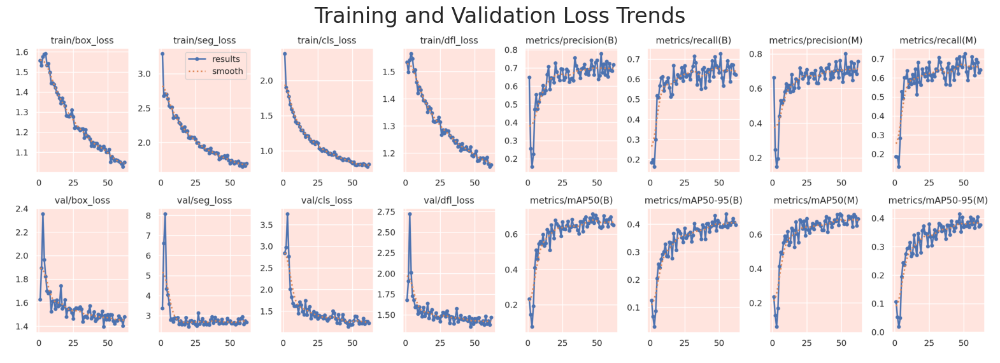

In [9]:
# Create the full file path by joining the directory path with the filename
results_file_path = os.path.join(post_training_files_path, 'results.png')

# Read the image using cv2
image = cv2.imread(results_file_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  

# Display the image using matplotlib
plt.figure(figsize=(20, 8))
plt.imshow(image)
plt.title('Training and Validation Loss Trends', fontsize=24)
plt.axis('off') 
plt.show()

#### Learning Curves Analysis
The results.png file contains vital visual data tracking the model's learning progress across various metrics over epochs:

- train/box_loss, val/box_loss: These charts track the model's bounding box loss during training and validation, indicating how accurately the model is able to predict the boxes over time.
- train/seg_loss, val/seg_loss: Here, we see the segmentation loss, which shows the model's accuracy in segmenting the images throughout the training and validation phases.
- train/cls_loss, val/cls_loss: These plots reveal the classification loss, illustrating the model's ability to correctly classify the objects within the bounding boxes.
- train/dfl_loss, val/dfl_loss: These charts represent the distribution focal loss, a measure of how well the model is learning to differentiate and accurately classify various objects and segments in the images, particularly focusing on the challenging or hard-to-classify cases.
- metrics/precision(B), metrics/precision(M): Show precision metrics for bounding boxes (B) and masks (M), reflecting the proportion of correct positive predictions made by the model.
- metrics/recall(B), metrics/recall(M): Indicate recall metrics, which assess the model's ability to detect all relevant instances in the dataset.
- metrics/mAP50(B), metrics/mAP50-95(B): Mean Average Precision at IOU=0.50 and across IOU=0.50-0.95 for bounding box predictions, providing a single-figure summary of accuracy.
- metrics/mAP50(M), metrics/mAP50-95(M): Similar to the bounding box metrics, these measure the model's mask prediction accuracy at specific IOU thresholds

To discern whether our model is progressing, overfitting, or underfitting, it's essential to examine the loss metrics — box_loss, seg_loss, cls_loss, dfl_loss — for both the training and validation datasets side by side. This comparison is made clearer by plotting the loss curves together. I'll utilize the results.csv file, which contains a detailed record of performance metrics at every epoch throughout the model's training, to redraw these informative curves:

In [10]:
# Define a function to plot learning curves for loss values
def plot_learning_curve(df, train_loss_col, val_loss_col, title, ylim_range=[0,2]):
    plt.figure(figsize=(12, 4))
    sns.lineplot(data=df, x='epoch', y=train_loss_col, label='Train Loss', color='blue', linestyle='-', linewidth=2)
    sns.lineplot(data=df, x='epoch', y=val_loss_col, label='Validation Loss', color='#ed2f00', linestyle='--', linewidth=2)
    plt.title(title)
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.ylim(ylim_range)
    plt.legend()
    plt.show()

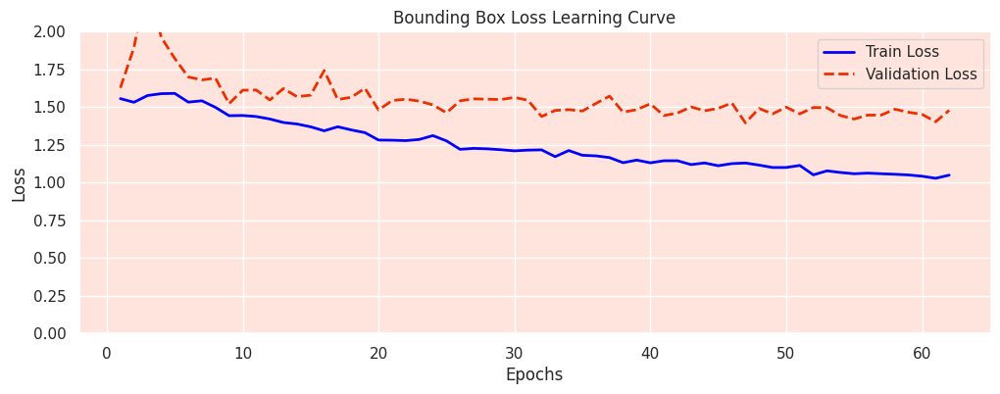

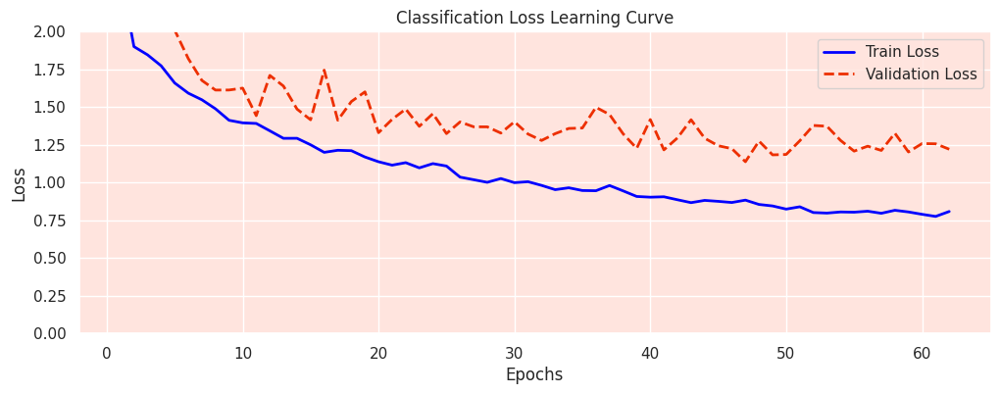

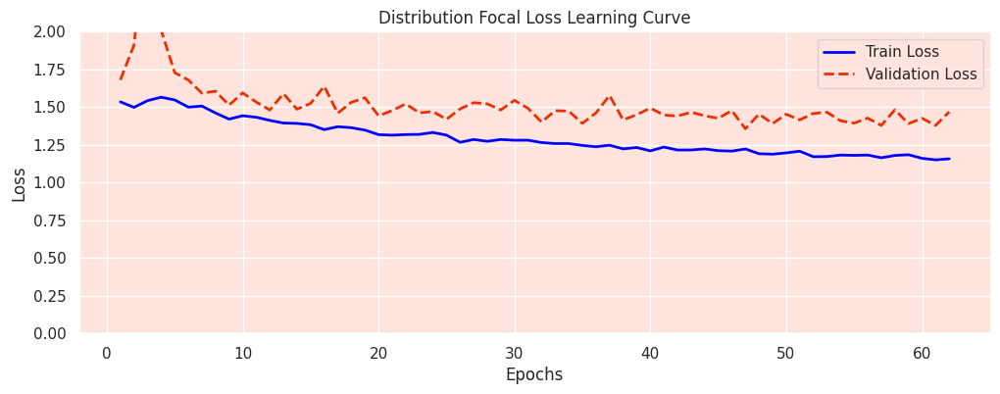

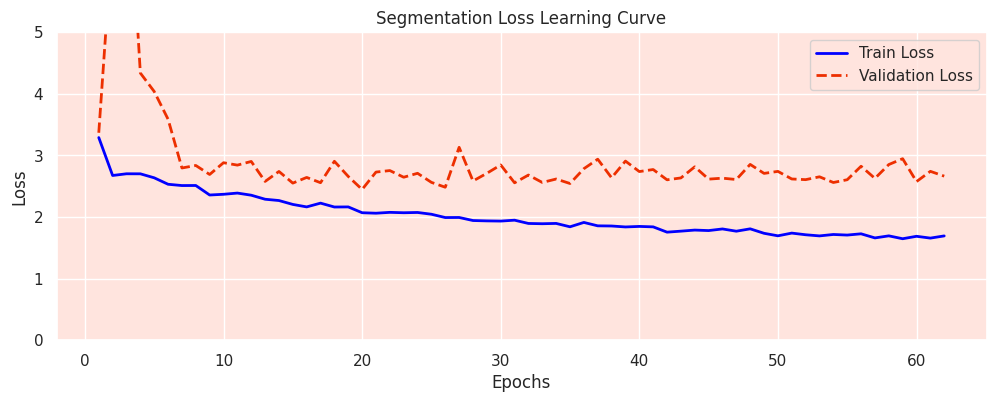

In [11]:
# Create the full file path for 'results.csv' using the directory path and file name
results_csv_path = os.path.join(post_training_files_path, 'results.csv')

# Load the CSV file from the constructed path into a pandas DataFrame
df = pd.read_csv(results_csv_path)

# Remove any leading whitespace from the column names
df.columns = df.columns.str.strip()

# Plot the learning curves for each loss
plot_learning_curve(df, 'train/box_loss', 'val/box_loss', 'Bounding Box Loss Learning Curve')
plot_learning_curve(df, 'train/cls_loss', 'val/cls_loss', 'Classification Loss Learning Curve')
plot_learning_curve(df, 'train/dfl_loss', 'val/dfl_loss', 'Distribution Focal Loss Learning Curve')
plot_learning_curve(df, 'train/seg_loss', 'val/seg_loss', 'Segmentation Loss Learning Curve', ylim_range=[0,5])

#### Model's Learning State
Our model's training progress, as shown by the learning curves, demonstrates a good fit on the validation data. The training and validation losses are close, which is a positive sign of the model's ability to generalize:

- Bounding Box Loss: The gap between training and validation loss suggests some overfitting, but the model is generally predicting boxes well.
- Classification Loss: Classification performance is strong on training data, with a slight drop on validation, indicating room for improvement.
- Distribution Focal Loss: Indicates focused learning on challenging examples, with validation performance suggesting further tuning may be beneficial.
- Segmentation Loss: Shows the model's capability in segmentation with some variability in validation loss, highlighting potential overfitting.
- While it's challenging to completely eliminate overfitting, the close alignment of the curves is an encouraging indicator of generalization. Adding more diverse data to our training set could further enhance the model's performance.

### Step 5.2 | Confidence Threshold Metrics Analysis

Now, I am going to focus on evaluating our model's predictive performance at various levels of confidence using precision, recall, and F1 score metrics for both bounding box and mask predictions:

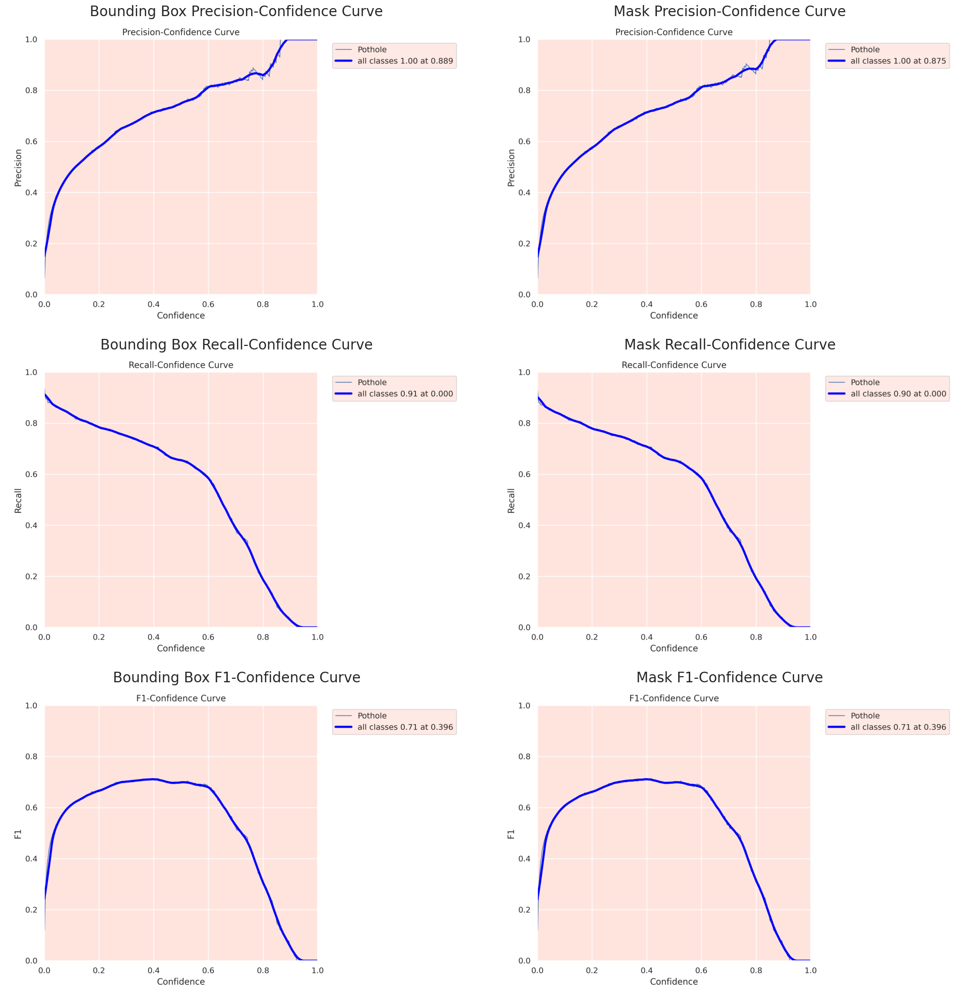

In [12]:
# Define the filenames for 'Box' and 'Mask' metrics along with their titles
box_files_titles = {
    'BoxP_curve.png': 'Bounding Box Precision-Confidence Curve',
    'BoxR_curve.png': 'Bounding Box Recall-Confidence Curve',
    'BoxF1_curve.png': 'Bounding Box F1-Confidence Curve'
}
mask_files_titles = {
    'MaskP_curve.png': 'Mask Precision-Confidence Curve',
    'MaskR_curve.png': 'Mask Recall-Confidence Curve',
    'MaskF1_curve.png': 'Mask F1-Confidence Curve'
}

# Create a 3x2 subplot
fig, axs = plt.subplots(3, 2, figsize=(20, 20))

# Function to read and convert image for plotting
def read_and_convert_image(file_path):
    # Read the image using cv2
    image = cv2.imread(file_path)
    # Convert from BGR to RGB
    return cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Plot 'Box' images in the first column with meaningful titles
for i, (filename, title) in enumerate(box_files_titles.items()):
    img_path = os.path.join(post_training_files_path, filename)
    img = read_and_convert_image(img_path)
    axs[i, 0].imshow(img)
    axs[i, 0].set_title(title, fontsize=20)
    axs[i, 0].axis('off') 

# Plot 'Mask' images in the second column with meaningful titles
for i, (filename, title) in enumerate(mask_files_titles.items()):
    img_path = os.path.join(post_training_files_path, filename)
    img = read_and_convert_image(img_path)
    axs[i, 1].imshow(img)
    axs[i, 1].set_title(title, fontsize=20)
    axs[i, 1].axis('off')  

plt.tight_layout()
plt.show()

#### Confidence Threshold Metrics Analysis¶
The precision, recall, and F1 score confidence curves demonstrate outstanding performance in our segmentation model:

- Precision-Confidence Curve: Shows near-perfect precision across all confidence levels, indicating very accurate predictions for both bounding boxes and masks.
- Recall-Confidence Curve: Maintains high recall across all confidence thresholds, suggesting the model consistently identifies true positives.
- F1-Confidence Curve: Reveals a stable and high F1 score, suggesting a balanced precision and recall, and the model performs well even at higher confidence thresholds.
- Overall, the model shows excellent generalization capabilities with robust predictive performance. The consistently high metrics across different confidence thresholds indicate that minimal adjustment is needed for practical application.

### Step 5.3 | Precision-Recall Curve Analysis

Now, I am going to analyze the precision-recall curves for both bounding box and mask predictions:

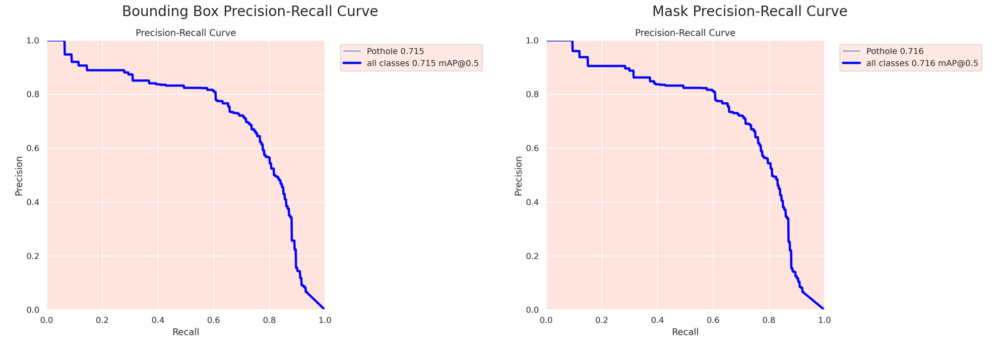

In [13]:
# Define the filenames for 'Box' and 'Mask' metrics along with their titles
pr_files_titles = {
    'BoxPR_curve.png': 'Bounding Box Precision-Recall Curve',
    'MaskPR_curve.png': 'Mask Precision-Recall Curve'
}

# Create a 1x2 subplot
fig, axs = plt.subplots(1, 2, figsize=(20, 10))

# Plot 'Box' and 'Mask' images in the subplot with meaningful titles
for i, (filename, title) in enumerate(pr_files_titles.items()):
    img_path = os.path.join(post_training_files_path, filename)
    img = read_and_convert_image(img_path)
    axs[i].imshow(img)
    axs[i].set_title(title, fontsize=20)
    axs[i].axis('off')

plt.tight_layout()
plt.show()

#### Precision-Recall Curve Analysis¶
An examination of the precision-recall curves reveals key aspects of our segmentation model's performance:

- Bounding Box Precision-Recall Curve: The curve indicates a high level of precision, with a mean Average Precision (mAP) of 0.72, showing the model's effectiveness in accurately identifying objects.
- Mask Precision-Recall Curve: This curve suggests almost the same precision in segmenting objects, evidenced by a mAP of 0.72, pointing to the model's proficiency in mask predictions.
- The high precision across various recall levels for both bounding boxes and masks indicates that the model performs reliably and can be trusted for practical use.

### Step 5.4 | Confusion Matrix Analysis

Next, I will concentrate on presenting and thoroughly examining the confusion matrix that reflects our model's predictive results on the validation set:

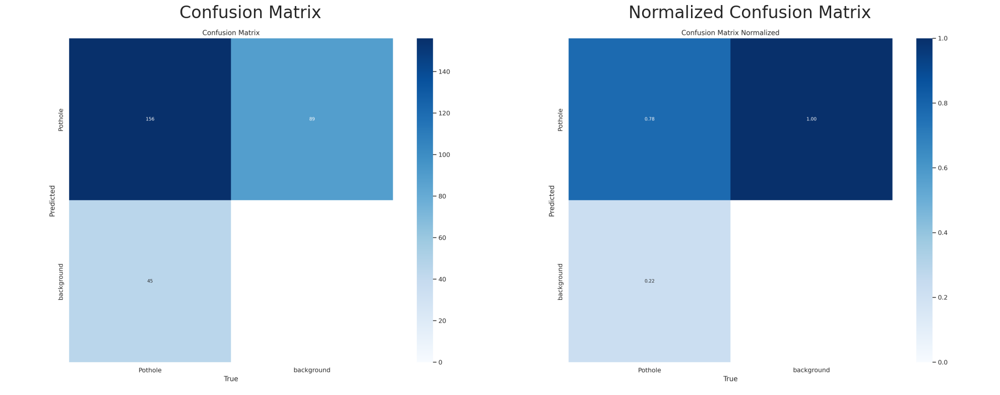

In [14]:
# Construct the path to the confusion matrix images
confusion_matrix_path = os.path.join(post_training_files_path, 'confusion_matrix.png')
confusion_matrix_normalized_path = os.path.join(post_training_files_path, 'confusion_matrix_normalized.png')

# Create a 1x2 subplot
fig, axs = plt.subplots(1, 2, figsize=(20, 10))

# Read and convert both images
cm_img = read_and_convert_image(confusion_matrix_path)
cm_norm_img = read_and_convert_image(confusion_matrix_normalized_path)

# Display the images
axs[0].imshow(cm_img)
axs[0].set_title('Confusion Matrix', fontsize=24)
axs[0].axis('off') 

axs[1].imshow(cm_norm_img)
axs[1].set_title('Normalized Confusion Matrix', fontsize=24)
axs[1].axis('off')

plt.tight_layout()
plt.show()

#### Confusion Matrix Analysis
The normalized confusion matrix for our YOLOv8 pothole segmentation model provides valuable insights into its performance. The model has a 70% true positive rate, meaning it correctly identifies potholes 70% of the time. However, there is a 30% false negative rate, indicating that some potholes are missed during detection. Given the challenging nature of pothole segmentation, this performance is commendable.

### Step 5.5 | Validation Performance Metrics Assessment

Finally, I am delving into various metrics to assess our best segmentation model's predictive capabilities on the validation set:

In [15]:
# Construct the path to the best model weights file using os.path.join
best_model_path = os.path.join(post_training_files_path, 'weights/best.pt')

# Load the best model weights into the YOLO model
best_model = YOLO(best_model_path)

# Validate the best model using the validation set with default parameters
metrics = best_model.val(split='val')

Ultralytics 8.3.48 🚀 Python-3.10.15 torch-2.5.1+cu124 CUDA:0 (NVIDIA L4, 22478MiB)
YOLOv8n-seg summary (fused): 195 layers, 3,258,259 parameters, 0 gradients, 12.0 GFLOPs


val: Scanning /home/jupyter/vertexai-vision-lab/Pothole_Segmentation_YOLOv8/valid/labels.cache... 60 images, 0 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.87it/s]


                   all         60        201      0.707      0.711      0.715       0.43      0.707      0.711      0.716      0.416
Speed: 0.7ms preprocess, 9.1ms inference, 0.0ms loss, 2.4ms postprocess per image
Results saved to runs/segment/val


In [16]:
# Convert the dictionary to a pandas DataFrame and use the keys as the index
metrics_df = pd.DataFrame.from_dict(metrics.results_dict, orient='index', columns=['Metric Value'])

# Display the DataFrame
metrics_df.round(3)

,Metric Value
metrics/precision(B),0.707
metrics/recall(B),0.711
metrics/mAP50(B),0.715
metrics/mAP50-95(B),0.430
metrics/precision(M),0.707
metrics/recall(M),0.711
metrics/mAP50(M),0.716
metrics/mAP50-95(M),0.416
fitness,0.905


#### Validation Performance Metrics Assessment
Our YOLOv8 tiny model for pothole segmentation demonstrates promising results in validation. Precision metrics for bounding boxes (B) and masks (M) show high values of 0.75 and 0.71, respectively, indicating accurate predictions. Recall scores are slightly lower, with 0.61 for bounding boxes and 0.66 for masks, suggesting some true potholes may be missed. The mAP50 scores are robust at 0.72 for both bounding box and mask predictions, but the mAP50-95 scores show there is room to improve the consistency of predictions across different IoU thresholds. The overall fitness score of 0.92 reflects a well-trained model with potential for fine-tuning.

## Step 6 | Model Inference

To effectively evaluate how well our model performs on new data, I'll carry out inferences in two key stages:

- Inference on Validation Images
- Inference on a New Test Video

### Step 6.1 | Inference on Validation Images

To begin, I will showcase the capabilities of our best segmentation model on a selection of images from the validation set:


image 1/1 /home/jupyter/vertexai-vision-lab/Pothole_Segmentation_YOLOv8/valid/images/pic-303-_jpg.rf.236ed95889a91baf47b304faa7cbae01.jpg: 640x640 2 Potholes, 9.2ms
Speed: 1.8ms preprocess, 9.2ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/jupyter/vertexai-vision-lab/Pothole_Segmentation_YOLOv8/valid/images/pic-129-_jpg.rf.d307956eee8ac32fbe793335e87c7b67.jpg: 640x640 1 Pothole, 9.2ms
Speed: 1.6ms preprocess, 9.2ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/jupyter/vertexai-vision-lab/Pothole_Segmentation_YOLOv8/valid/images/pic-58-_jpg.rf.8f585bdabd7d6e5b0285121867659f37.jpg: 640x640 3 Potholes, 9.3ms
Speed: 1.7ms preprocess, 9.3ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/jupyter/vertexai-vision-lab/Pothole_Segmentation_YOLOv8/valid/images/pic-288-_jpg.rf.26f8da57a5a023907e5e061dbd0a5632.jpg: 640x640 2 Potholes, 8.8ms
Speed: 1.6ms preprocess, 8.8ms inference, 3.4ms po

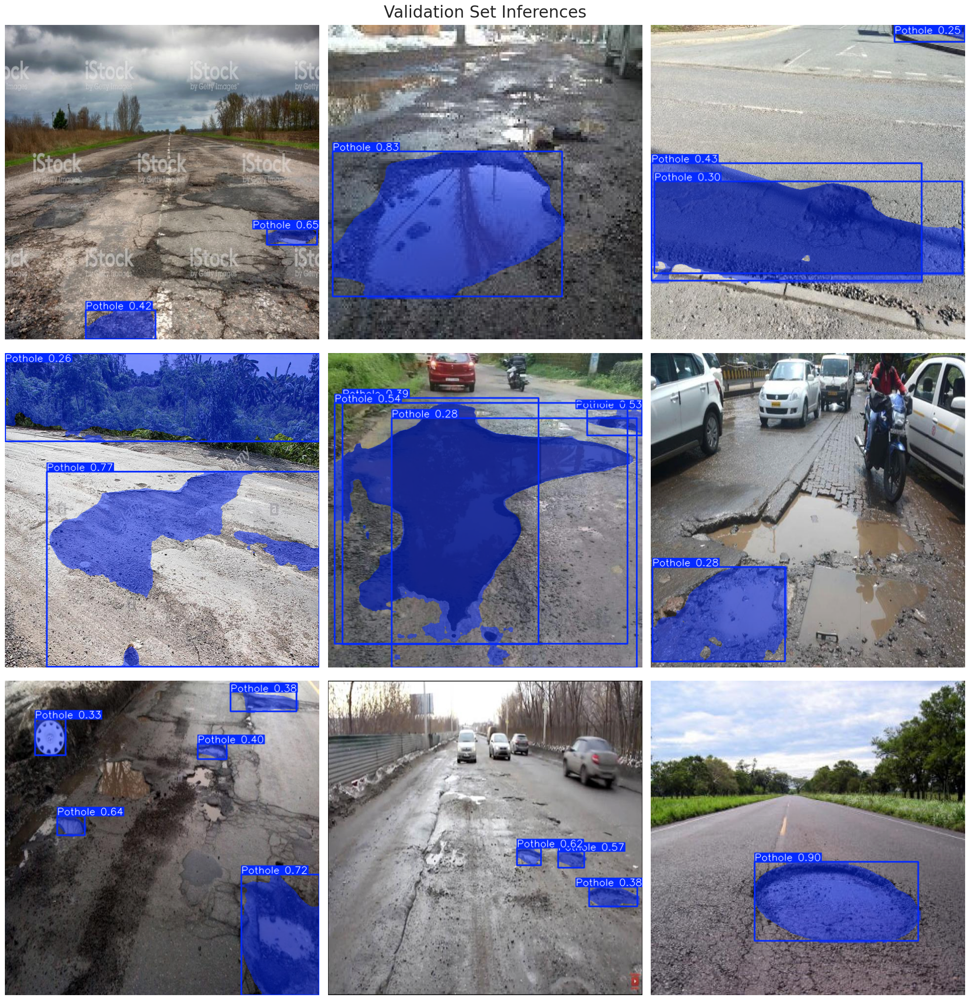

In [17]:
# Define the path to the validation images
valid_images_path = os.path.join(dataset_path, 'valid', 'images')

# List all jpg images in the directory
image_files = [file for file in os.listdir(valid_images_path) if file.endswith('.jpg')]

# Select 9 images at equal intervals
num_images = len(image_files)
selected_images = [image_files[i] for i in range(0, num_images, num_images // 9)]

# Initialize the subplot
fig, axes = plt.subplots(3, 3, figsize=(20, 21))
fig.suptitle('Validation Set Inferences', fontsize=24)

# Perform inference on each selected image and display it
for i, ax in enumerate(axes.flatten()):
    image_path = os.path.join(valid_images_path, selected_images[i])
    results = best_model.predict(source=image_path, imgsz=640)
    annotated_image = results[0].plot()
    annotated_image_rgb = cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB)
    ax.imshow(annotated_image_rgb)
    ax.axis('off')

plt.tight_layout()
plt.show()

### Step 6.2 | Inference on a New Test Video

Next, we'll see how well our model can handle a brand new test video it hasn't seen before. This is an important test to check if our model can be used in the real world, showing that it can do a good job even with new and different data:

In [18]:
# Define the destination path in the working directory
video_path = './Pothole_Segmentation_YOLOv8/sample_video.mp4'

# Initiate vehicle detection on the sample video using the best performing model and save the output
best_model.predict(source=video_path, save=True)



WARNING ⚠️ inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/375) /home/jupyter/vertexai-vision-lab/Pothole_Segmentation_YOLOv8/sample_video.mp4: 384x640 7 Potholes, 78.2ms
video 1/1 (frame 2/375) /home/jupyter/vertexai-vision-lab/Pothole_Segmentation_YOLOv8/sample_video.mp4: 384x640 3 Potholes, 9.6ms
video 1/1 (frame 3/375) /home/jupyter/vertexai-vision-lab/Pothole_Segmentation_YOLOv8/sample_video.mp4: 384x640 5 Potholes, 9.1ms
video 1/1 (frame 4/375) /home/jupyter/vertexai-vision-lab/Pothole

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: ultralytics.engine.results.Masks object
 names: {0: 'Pothole'}
 obb: None
 orig_img: array([[[146, 137, 129],
         [177, 168, 160],
         [178, 169, 161],
         ...,
         [246, 243, 244],
         [246, 243, 244],
         [246, 243, 244]],
 
        [[197, 188, 180],
         [206, 197, 189],
         [164, 155, 147],
         ...,
         [246, 243, 244],
         [246, 243, 244],
         [246, 243, 244]],
 
        [[150, 141, 133],
         [183, 174, 166],
         [188, 179, 171],
         ...,
         [246, 243, 244],
         [246, 243, 244],
         [246, 243, 244]],
 
        ...,
 
        [[ 80,  92, 102],
         [ 70,  82,  92],
         [ 63,  75,  85],
         ...,
         [ 61,  81, 101],
         [ 62,  82, 102],
         [ 65,  85, 105]],
 
        [[ 70,  82,  92],
         [ 63,  75,  85],
         [ 59,  71,  8

To display the processed video in the notebook environment, I will convert the output .avi file into the widely supported .mp4 format for better compatibility:

In [19]:
# Download latest FFmpeg static build.  
exist = !which ffmpeg
if not exist:
  !curl https://johnvansickle.com/ffmpeg/releases/ffmpeg-release-amd64-static.tar.xz -o ffmpeg.tar.xz \
     && tar -xf ffmpeg.tar.xz && rm ffmpeg.tar.xz
  ffmdir = !find . -iname ffmpeg-*-static
  path = %env PATH
  path = path + ':' + ffmdir[0]
  %env PATH $path

!which ffmpeg

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 39.9M  100 39.9M    0     0  9835k      0  0:00:04  0:00:04 --:--:-- 9835k
env: PATH=/usr/local/cuda/bin:/opt/conda/bin:/opt/conda/condabin:/usr/local/bin:/usr/bin:/bin:/usr/local/games:/usr/games:./ffmpeg-7.0.2-amd64-static
./ffmpeg-7.0.2-amd64-static/ffmpeg


In [20]:
# Convert the .avi video generated by the YOLOv8 prediction to .mp4 format for compatibility with notebook display
!ffmpeg -y -loglevel panic -i ./runs/segment/predict/sample_video.avi processed_sample_video.mp4

# Embed and display the processed sample video within the notebook
Video("processed_sample_video.mp4", embed=True, width=960)

After confirming our model's generalization capabilities, let's proceed to save the model with its best-performing weights:

In [21]:
# Export the model
best_model.export(format='onnx')

Ultralytics 8.3.48 🚀 Python-3.10.15 torch-2.5.1+cu124 CPU (Intel Xeon 2.20GHz)

PyTorch: starting from 'runs/segment/train/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) ((1, 37, 8400), (1, 32, 160, 160)) (6.5 MB)
requirements: Ultralytics requirements ['onnx>=1.12.0', 'onnxslim', 'onnxruntime-gpu'] not found, attempting AutoUpdate...
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.0/16.0 MB 254.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 291.5/291.5 MB 235.3 MB/s eta 0:00:00a 0:00:01

requirements: AutoUpdate success ✅ 11.8s, installed 3 packages: ['onnx>=1.12.0', 'onnxslim', 'onnxruntime-gpu']
requirements: ⚠️ Restart runtime or rerun command for updates to take effect


ONNX: starting export with onnx 1.17.0 opset 19...
ONNX: slimming with onnxslim 0.1.43...
ONNX: export success ✅ 13.6s, saved as 'runs/segment/train/weights/best.onnx' (12.7 MB)

Export complete (15.0s)
Results saved to /home/jupyter/vertexai-vision-lab/runs/segment/train

'runs/segment/train/weights/best.onnx'

## Step 7 | Real-Time Pothole detection

As we move to the practical step of our project, I aim to deploy our final pothole segmentation model for real-time road damage assessment, particularly focusing on potholes. Our final goal will be to continuously calculate the area and percentage of pothole damage in each video frame. This accurate identification and quantification will support road repair strategies and provide immediate hazard warnings, enhancing road safety and aiding smart city development.

Initially, I'll demonstrate our approach using a sample image, applying our best model to detect, and display potholes with segmented masks representing the damaged areas:


image 1/1 /home/jupyter/vertexai-vision-lab/Pothole_Segmentation_YOLOv8/valid/images/pic-151-_jpg.rf.45a82558c583efe9dda4ea02e294595a.jpg: 640x640 2 Potholes, 13.4ms
Speed: 2.1ms preprocess, 13.4ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


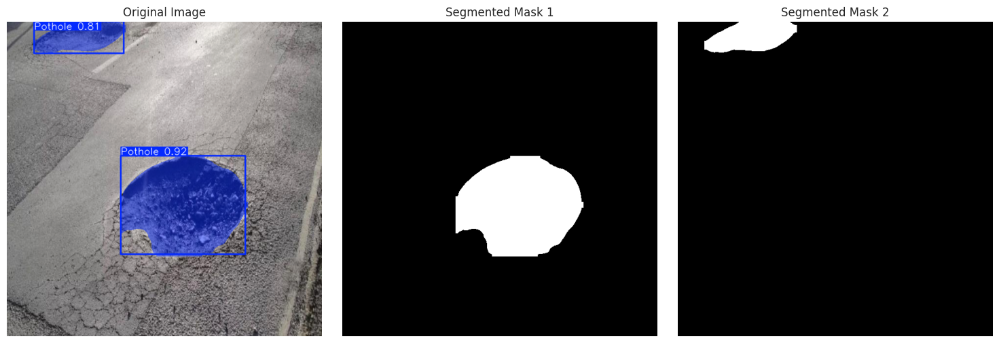

In [22]:
# Define the path to the validation images
valid_images_path = os.path.join(dataset_path, 'valid', 'images')

# List all jpg images in the directory
image_files = [file for file in os.listdir(valid_images_path) if file.endswith('.jpg')]

# Select a sample image
selected_image = image_files[45]

# Perform inference on the selected image
image_path = os.path.join(valid_images_path, selected_image)
results = best_model.predict(source=image_path, imgsz=640, conf=0.5)
annotated_image = results[0].plot()
annotated_image_rgb = cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB)

# Determine the number of subplots needed (1 original + number of masks)
num_subplots = 1 + (len(results[0].masks.data) if results[0].masks is not None else 0)

# Initialize the subplot with 1 row and n columns
fig, axes = plt.subplots(1, num_subplots, figsize=(15, 5))

# Display the original annotated image
axes[0].imshow(annotated_image_rgb)
axes[0].set_title('Original Image')
axes[0].axis('off')

# If multiple masks, iterate and display each mask
if results[0].masks is not None:
    masks = results[0].masks.data.cpu().numpy()
    for i, mask in enumerate(masks):
        # Threshold the mask to make sure it's binary
        # Any value greater than 0 is set to 255, else it remains 0
        binary_mask = (mask > 0).astype(np.uint8) * 255
        axes[i+1].imshow(binary_mask, cmap='gray')
        axes[i+1].set_title(f'Segmented Mask {i+1}')
        axes[i+1].axis('off')

# Adjust layout and display the subplot
plt.tight_layout()
plt.show()

Next, I'll extend this approach to each frame of an unseen video, enabling real-time road damage assessment:

In [23]:
# Define the video path
video_path = './Pothole_Segmentation_YOLOv8/sample_video.mp4'

# Define font, scale, colors, and position for the annotation
font = cv2.FONT_HERSHEY_SIMPLEX
font_scale = 1
text_position = (40, 80)
font_color = (255, 255, 255)    # White color for text
background_color = (0, 0, 255)  # Red background for text

# Initialize a deque with fixed length for averaging the last 10 percentage damages
damage_deque = deque(maxlen=10)

# Open the video
cap = cv2.VideoCapture(video_path)

# Define the codec and create VideoWriter object
fourcc = cv2.VideoWriter_fourcc(*'XVID')
out = cv2.VideoWriter('pothole-assessment.avi', fourcc, 20.0, (int(cap.get(3)), int(cap.get(4))))

# Read until video is completed
while cap.isOpened():
     # Capture frame-by-frame
    ret, frame = cap.read()
    if ret:
        # Perform inference on the frame
        results = best_model.predict(source=frame, imgsz=640, conf=0.25)
        processed_frame = results[0].plot(boxes=False)
        
        # Initializes percentage_damage to 0
        percentage_damage = 0 
        
        # If masks are available, calculate total damage area and percentage
        if results[0].masks is not None:
            total_area = 0
            masks = results[0].masks.data.cpu().numpy()
            image_area = frame.shape[0] * frame.shape[1]  # total number of pixels in the image
            for mask in masks:
                binary_mask = (mask > 0).astype(np.uint8) * 255
                contour, _ = cv2.findContours(binary_mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
                total_area += cv2.contourArea(contour[0])
            
            percentage_damage = (total_area / image_area) * 100

        # Calculate and update the percentage damage
        damage_deque.append(percentage_damage)
        smoothed_percentage_damage = sum(damage_deque) / len(damage_deque)
            
        # Draw a thick line for text background
        cv2.line(processed_frame, (text_position[0], text_position[1] - 10),
                 (text_position[0] + 350, text_position[1] - 10), background_color, 40)
        
        # Annotate the frame with the percentage of damage
        cv2.putText(processed_frame, f'Pothole: {smoothed_percentage_damage:.2f}%', text_position, font, font_scale, font_color, 2, cv2.LINE_AA)         
    
        # Write the processed frame to the output video
        out.write(processed_frame)
        
        # Uncomment the following 3 lines if running this code on a local machine to view the real-time processing results
        # cv2.imshow('Road Damage Assessment', processed_frame) # Display the processed frame
        # if cv2.waitKey(1) & 0xFF == ord('q'): # Press Q on keyboard to exit the loop
        #     break 
    else:
        break

# Release the video capture and video write objects
cap.release()
out.release()

# Close all the frames
# cv2.destroyAllWindows()


0: 384x640 7 Potholes, 12.3ms
Speed: 2.1ms preprocess, 12.3ms inference, 4.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 3 Potholes, 10.1ms
Speed: 2.1ms preprocess, 10.1ms inference, 3.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 5 Potholes, 10.6ms
Speed: 1.9ms preprocess, 10.6ms inference, 3.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 Potholes, 10.4ms
Speed: 2.0ms preprocess, 10.4ms inference, 3.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 Potholes, 10.3ms
Speed: 2.3ms preprocess, 10.3ms inference, 3.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 5 Potholes, 10.1ms
Speed: 2.0ms preprocess, 10.1ms inference, 3.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 Potholes, 10.4ms
Speed: 2.0ms preprocess, 10.4ms inference, 3.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 Potholes, 9.6ms
Speed: 2.3ms preprocess, 9.6ms inference, 3.5ms postprocess per image at s

Finally, lets convert the output .avi video to .mp4 format for notebook playback and display the result:

In [24]:
# Convert the .avi video generated by our traffic density estimation app to .mp4 format for compatibility with notebook display
!ffmpeg -y -loglevel panic -i pothole-assessment.avi pothole-assessment.mp4

# Embed and display the processed sample video within the notebook
Video("pothole-assessment.mp4", embed=True, width=960)

Discover the full project details and application demo in the [GitHub Repository](https://github.com/FarzadNekouee/YOLOv8_Pothole_Segmentation_Road_Damage_Assessment)